###Installation and Setup for Basic Human Object Detector

In [ ]:
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
import torch, torchvision
torch.__version__

In [4]:
from google.colab import drive
drive.mount('/content/gdrive')
%cd /content/gdrive/.shortcut-targets-by-id/1Eg2dTJ9lloHImzZiTfOZ7_jOP1sTh--c/6.869 Project/v-coco/

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
/content/gdrive/.shortcut-targets-by-id/1Eg2dTJ9lloHImzZiTfOZ7_jOP1sTh--c/6.869 Project/v-coco


In [4]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

fatal: destination path 'detectron2_repo' already exists and is not an empty directory.
Obtaining file:///content/gdrive/.shortcut-targets-by-id/1Eg2dTJ9lloHImzZiTfOZ7_jOP1sTh--c/6.869%20Project/v-coco/detectron2_repo
  Using cached fvcore-0.1.5.post20220506-py3-none-any.whl
  Using cached hydra_core-1.1.2-py3-none-any.whl (147 kB)
  Using cached black-21.4b2-py3-none-any.whl (130 kB)
  Using cached scipy-1.7.3-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.whl (38.1 MB)
  Running setup.py develop for detectron2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [1]:
# Some basic setup:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

### Run a pre-trained person detector / object detector

In [ ]:
# !wget http://images.cocodataset.org/val2017/000000439715.jpg -q -O input.jpg
# https://mashcrunchh.files.wordpress.com/2020/04/buy.jpg?w=1100&h=768&crop=1
# !wget https://image.cnbcfm.com/api/v1/image/106473821-1585931052853woman-makes-purchases-in-the-store-novelty-consultation-woman-adult-fashion-consumer-indoor-human_t20_2j43do.jpg?v=1589393266&w=630&h=354 -q -O input.jpg
# im = cv2.imread("./input.jpg")
# cv2_imshow(im)

In [5]:
%pwd

'/content/gdrive/.shortcut-targets-by-id/1Eg2dTJ9lloHImzZiTfOZ7_jOP1sTh--c/6.869 Project/v-coco'

In [7]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("coco_14_train1", {}, "./coco/annotations/instances_train2014.json", "./coco/train2014")

train_metadata = MetadataCatalog.get("coco_14_train1")
train_dicts = DatasetCatalog.get("coco_14_train1")

register_coco_instances("coco_14_val1", {}, "./coco/annotations/instances_val2014.json", "./coco/val2014")

val_metadata = MetadataCatalog.get("coco_14_val1")
val_dicts = DatasetCatalog.get("coco_14_val1")

[05/09 14:00:24 d2.data.datasets.coco]: Loading ./coco/annotations/instances_train2014.json takes 16.29 seconds.
[05/09 14:00:25 d2.data.datasets.coco]: Loaded 82783 images in COCO format from ./coco/annotations/instances_train2014.json
[05/09 14:00:40 d2.data.datasets.coco]: Loading ./coco/annotations/instances_val2014.json takes 8.87 seconds.
[05/09 14:00:40 d2.data.datasets.coco]: Loaded 40504 images in COCO format from ./coco/annotations/instances_val2014.json


In [8]:
#Get the default config and set for pre-made RCNN Object Detector
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
cfg.DATASETS.TEST = ("coco_14_val1", )


model_final_f10217.pkl: 178MB [00:35, 4.96MB/s]                           


In [11]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.engine import DefaultTrainer

cfg.TEST.EVAL_PERIOD = 100
evaluator = [COCOEvaluator("coco_14_val1", cfg, False)]
# val_loader = build_detection_test_loader(cfg, "rel_grocery_val")
# inference_on_dataset(trainer.model, val_loader, evaluator)
model = DefaultTrainer.build_model(cfg)
metrics = DefaultTrainer.test(cfg, model, evaluator)

WARNING [05/09 14:07:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/09 14:07:55 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
 

/usr/local/lib/python3.7/dist-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/09 14:08:29 d2.evaluation.evaluator]: Inference done 11/40504. Dataloading: 0.0011 s/iter. Inference: 0.1092 s/iter. Eval: 0.0164 s/iter. Total: 0.1267 s/iter. ETA=1:25:31
[05/09 14:08:35 d2.evaluation.evaluator]: Inference done 43/40504. Dataloading: 0.0406 s/iter. Inference: 0.1075 s/iter. Eval: 0.0110 s/iter. Total: 0.1591 s/iter. ETA=1:47:18
[05/09 14:08:40 d2.evaluation.evaluator]: Inference done 72/40504. Dataloading: 0.0518 s/iter. Inference: 0.1080 s/iter. Eval: 0.0099 s/iter. Total: 0.1699 s/iter. ETA=1:54:30
[05/09 14:08:45 d2.evaluation.evaluator]: Inference done 103/40504. Dataloading: 0.0485 s/iter. Inference: 0.1094 s/iter. Eval: 0.0097 s/iter. Total: 0.1677 s/iter. ETA=1:52:54
[05/09 14:08:50 d2.evaluation.evaluator]: Inference done 131/40504. Dataloading: 0.0525 s/iter. Inference: 0.1090 s/iter. Eval: 0.0091 s/iter. Total: 0.1706 s/iter. ETA=1:54:48
[05/09 14:08:55 d2.evaluation.evaluator]: Inference done 163/40504. Dataloading: 0.0491 s/iter. Inference: 0.1102 s/it

In [12]:
image_list = ['image01.jpeg', 'image02.jpeg', 'image03.jpeg', 'image04.jpeg', 'image05.jpeg', 'image06.png', 'image07.jpeg', 'image08.jpeg', 'image09.png', 'image10.jpeg', 'image11.png', 'image12.jpeg', 'image13.jpeg', 'image14.jpeg', 'image36.jpeg', 'image37.jpeg', 'image38.jpeg', 'image39.jpeg', 'image40.jpeg', 'image41.jpeg', 'image42.jpeg', 'image43.jpeg', 'image44.jpeg', 'image45.jpeg', 'image46.jpeg', 'image47.jpeg', 'image48.jpeg', 'image49.jpeg', 'image50.jpeg']


In [13]:
len(image_list)

29

image01.jpeg


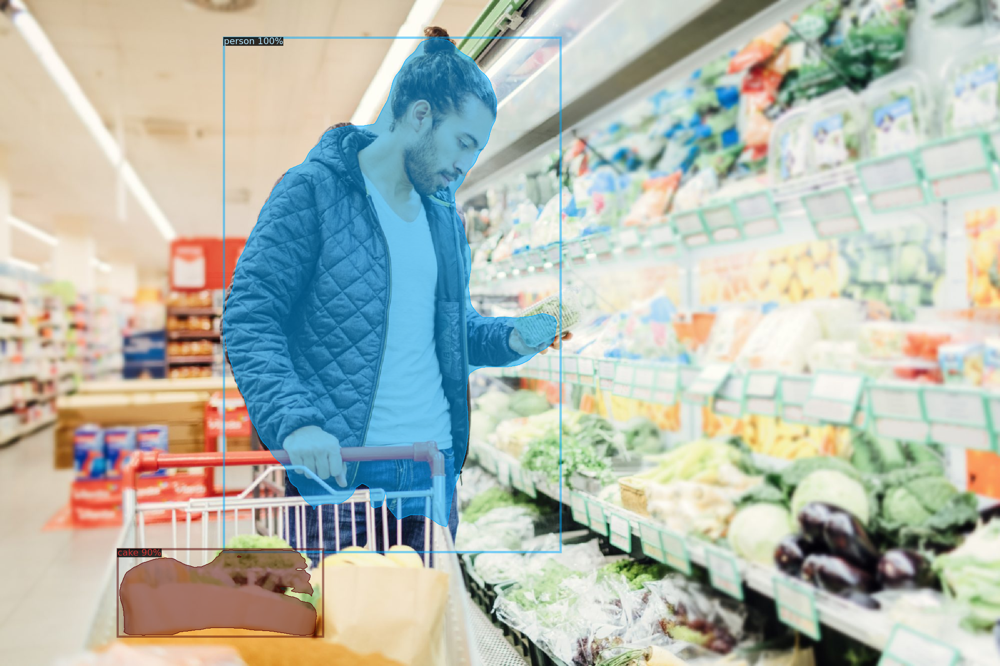

image02.jpeg


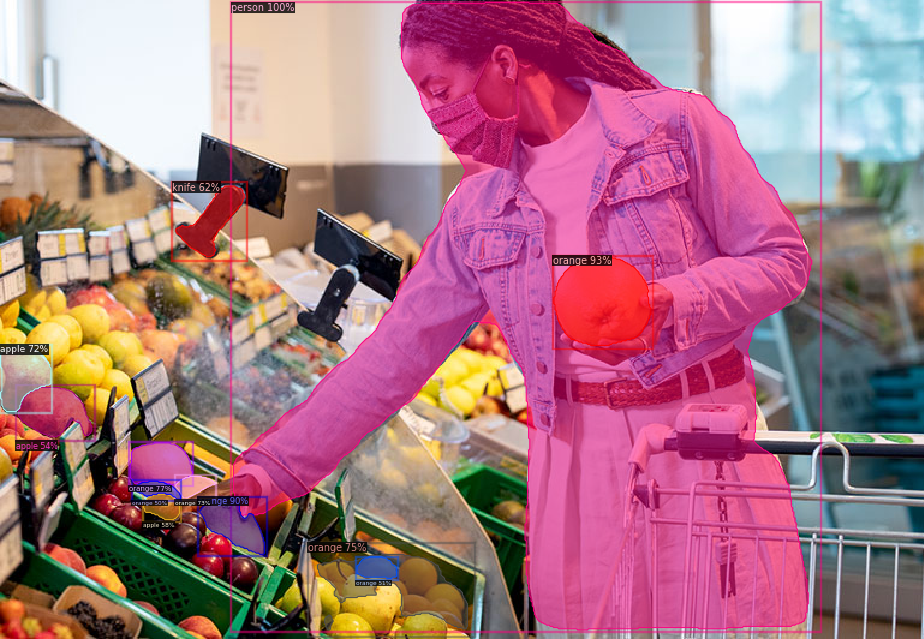

image03.jpeg


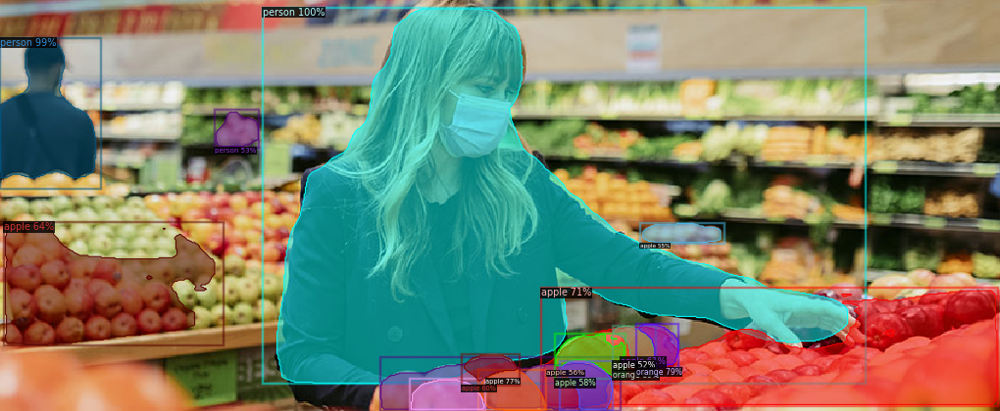

image04.jpeg


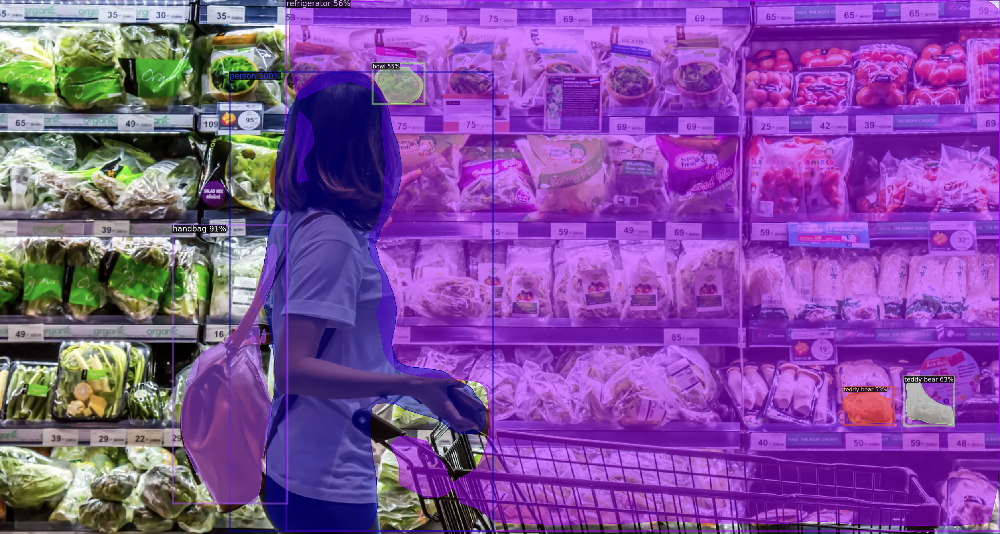

image05.jpeg


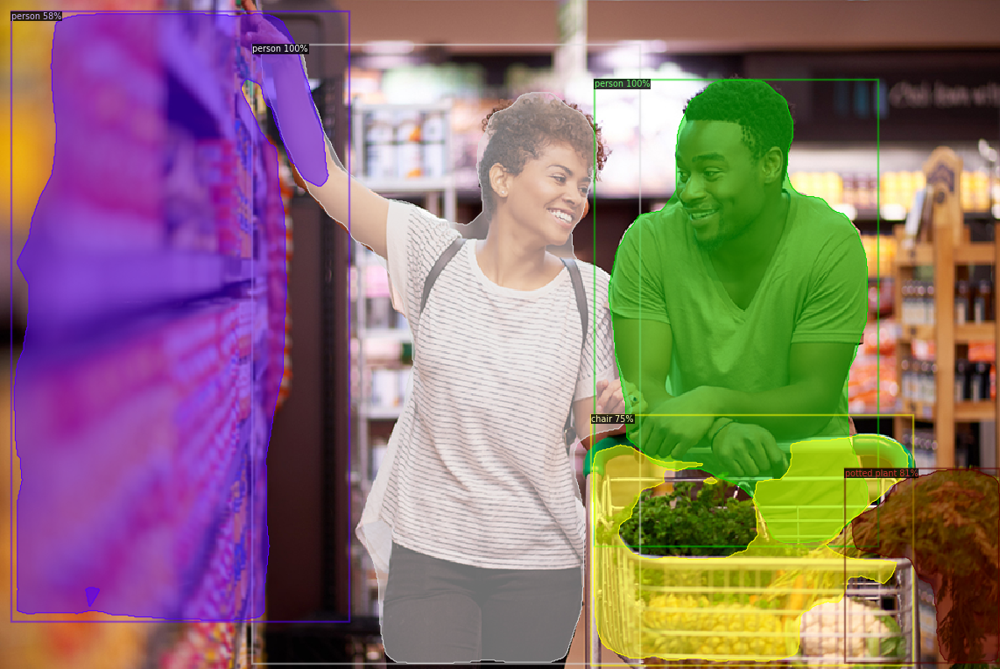

image06.png


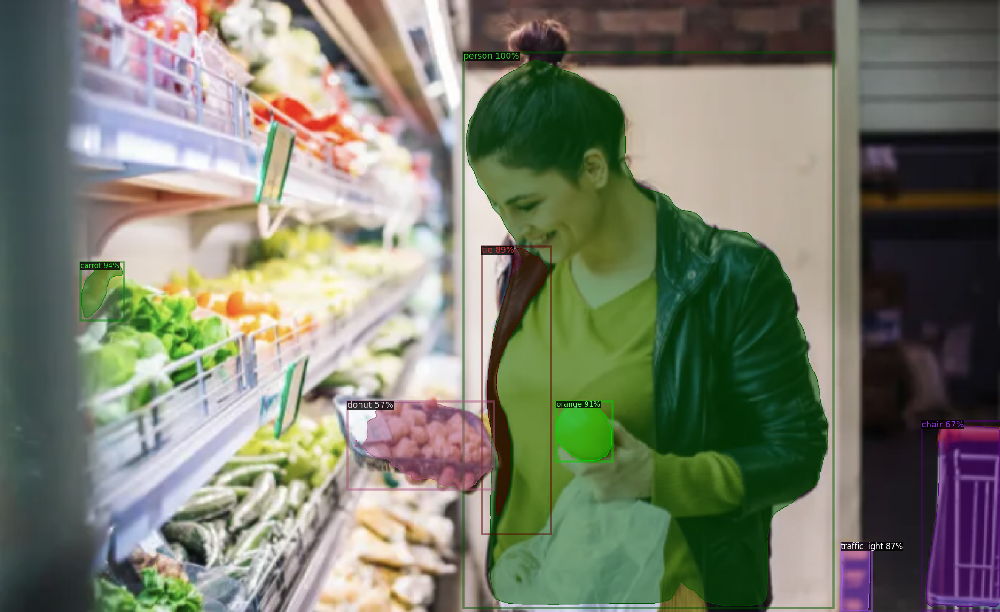

image07.jpeg


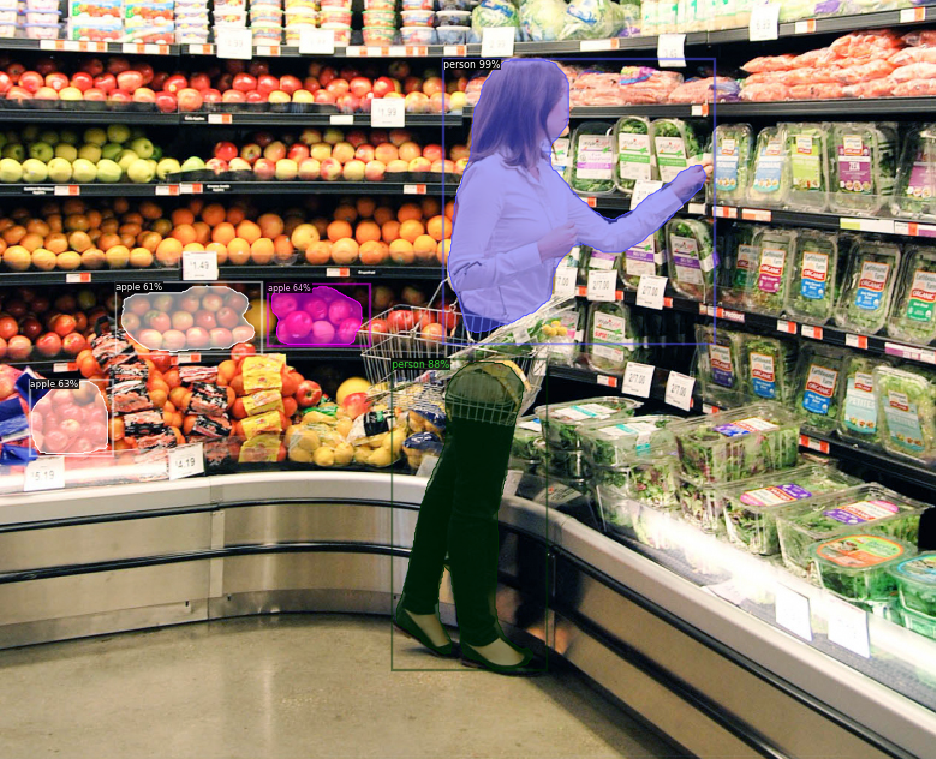

image08.jpeg


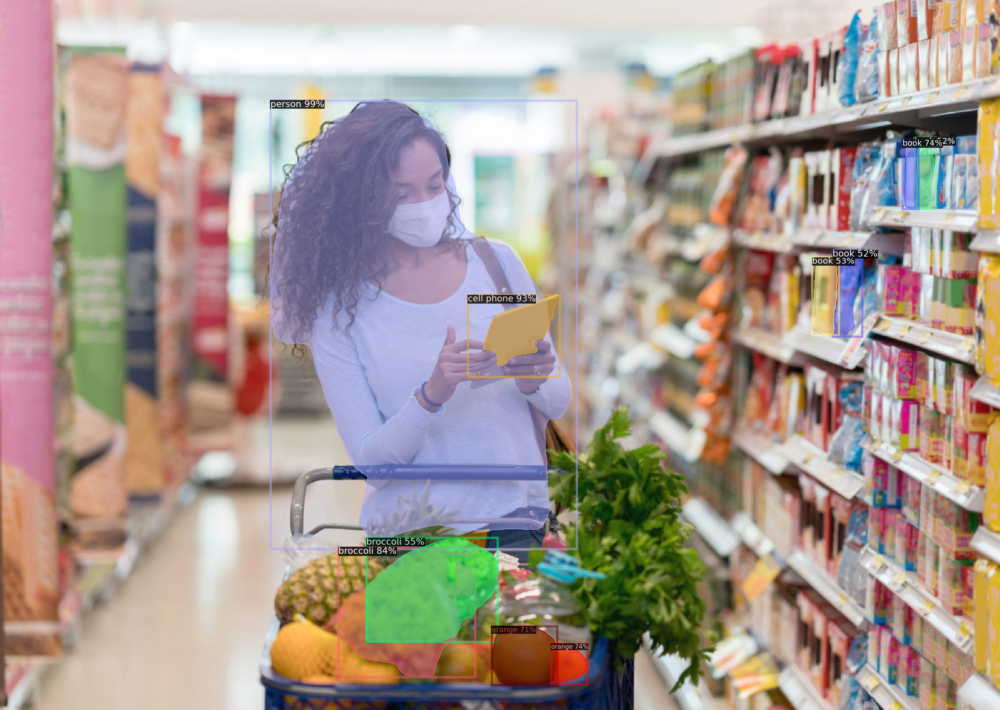

image09.png


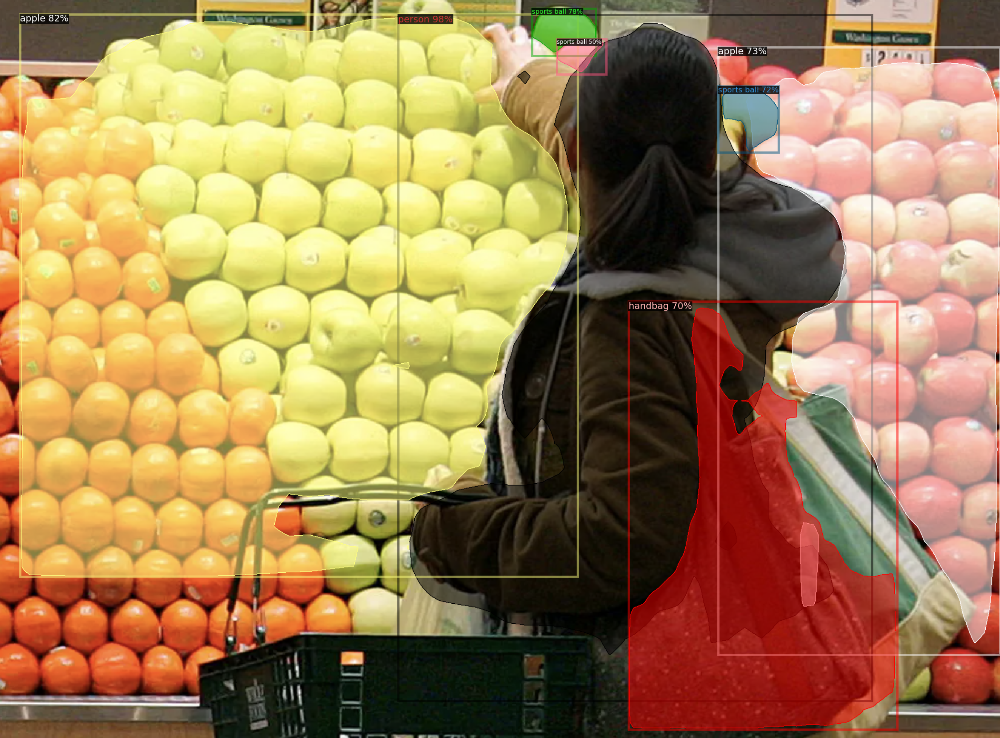

image10.jpeg


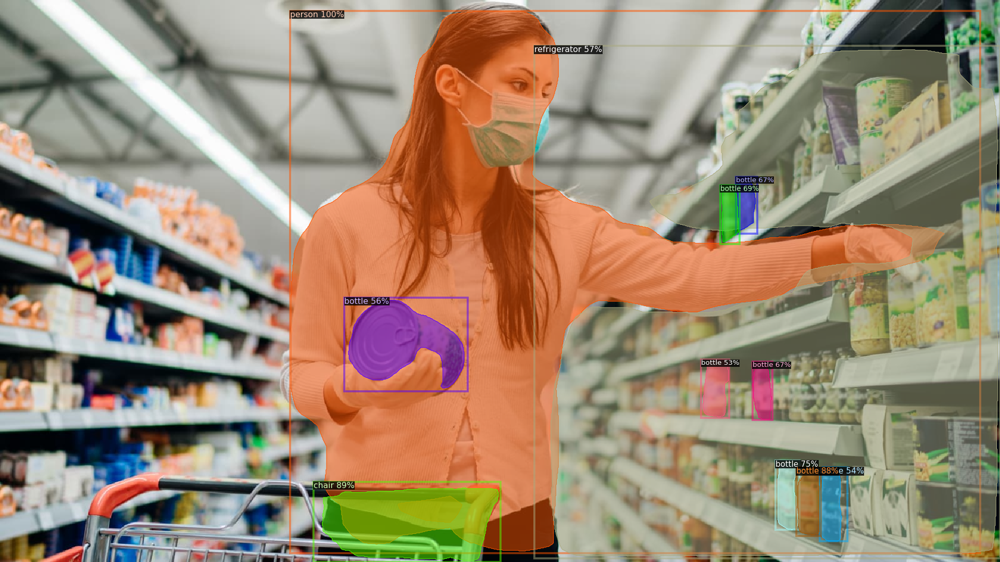

image11.png


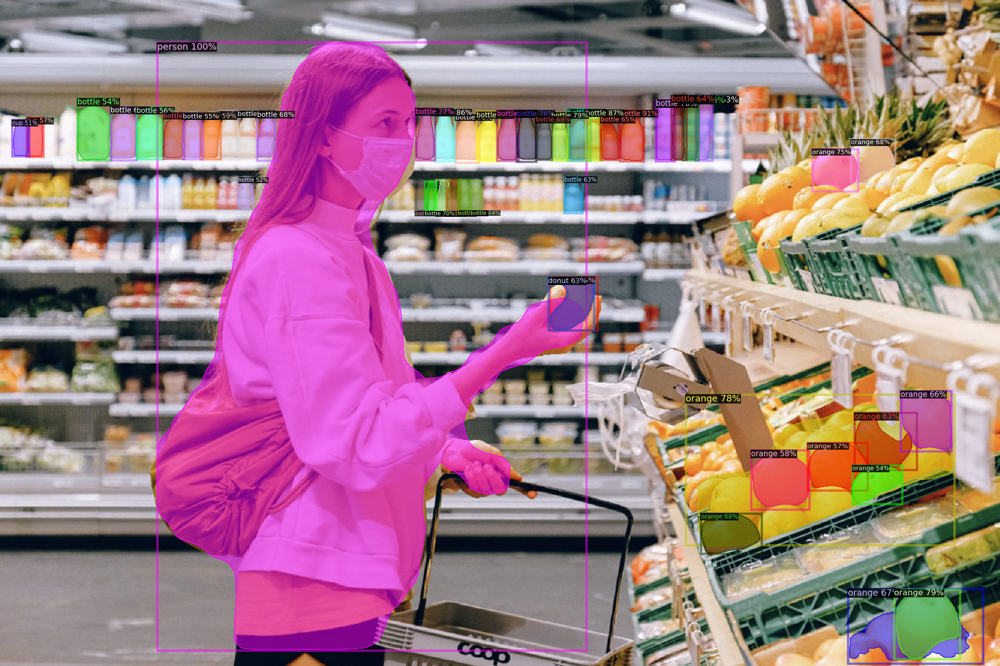

image12.jpeg


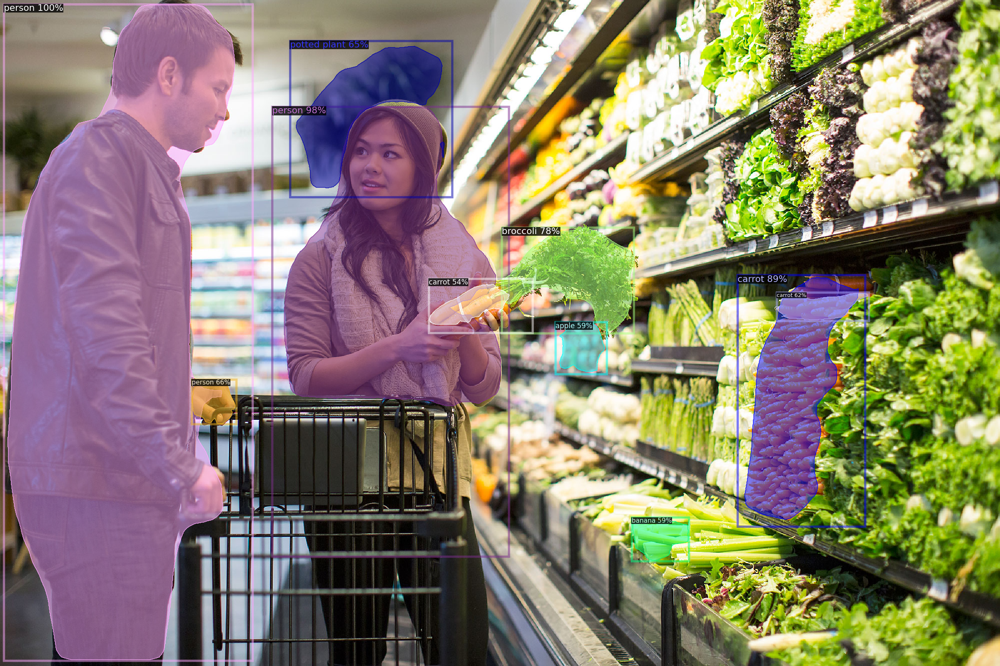

image13.jpeg


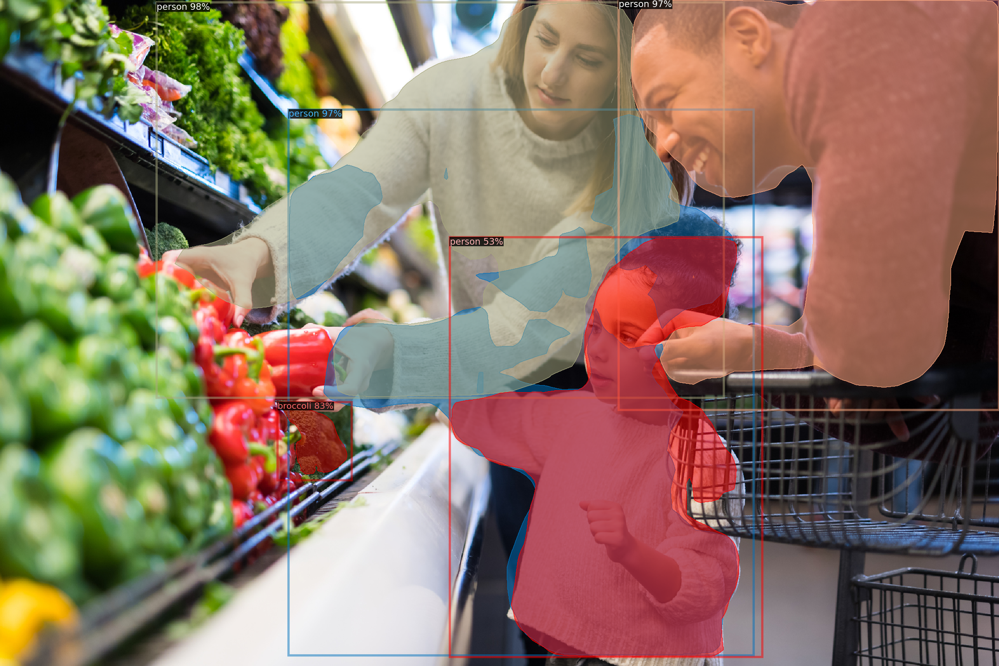

image14.jpeg


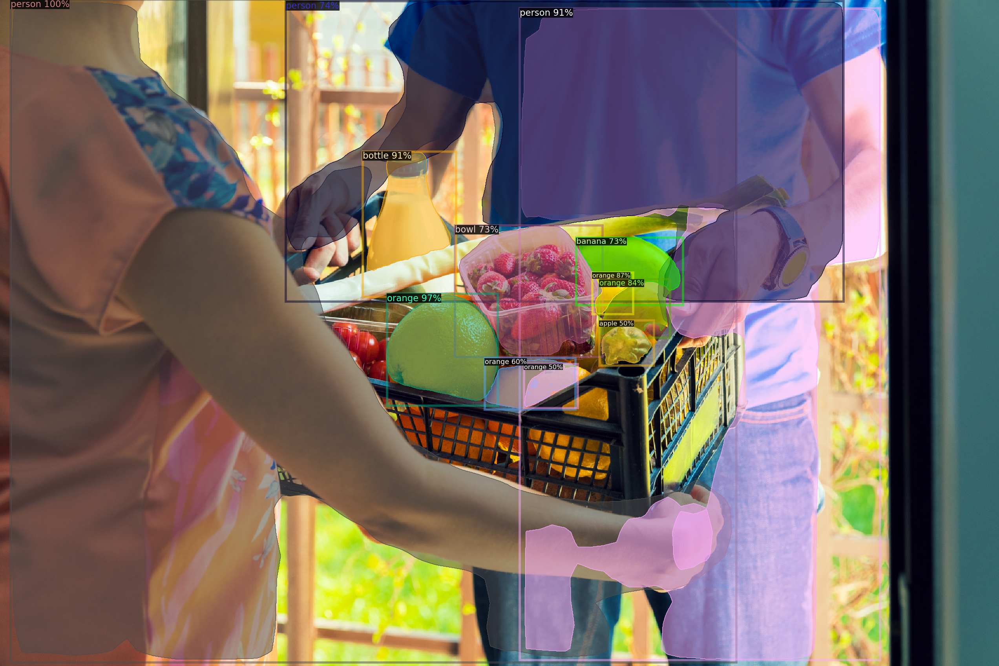

image36.jpeg


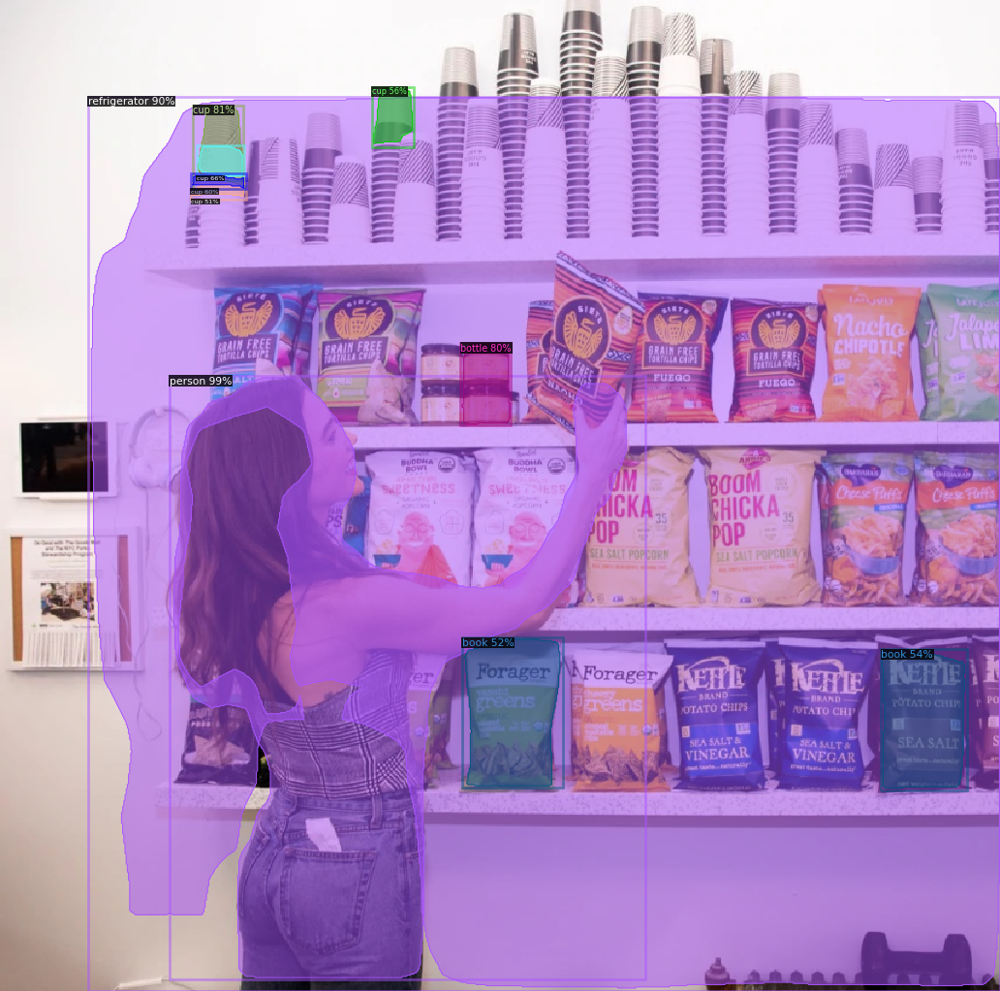

image37.jpeg
Buffered data was truncated after reaching the output size limit.

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

image_list = ['image01.jpeg', 'image02.jpeg', 'image03.jpeg', 'image04.jpeg', 'image05.jpeg', 'image06.png', 'image07.jpeg', 'image08.jpeg', 'image09.png', 'image10.jpeg', 'image11.png', 'image12.jpeg', 'image13.jpeg', 'image14.jpeg', 'image36.jpeg', 'image37.jpeg', 'image38.jpeg', 'image39.jpeg', 'image40.jpeg', 'image41.jpeg', 'image42.jpeg', 'image43.jpeg', 'image44.jpeg', 'image45.jpeg', 'image46.jpeg', 'image47.jpeg', 'image48.jpeg', 'image49.jpeg', 'image50.jpeg']
for i in image_list:
  im = cv2.imread(f"../GroceryImages/{i}")
  print(i)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
  out.save(f"../sandbox/annotated_shopping/person_model/{i}")